# Step 1: Create the Images

We need "not waldos" and we need "waldos" for our neural network to train on. Let us start with making some "not waldos".

In [ ]:
%matplotlib inline
#The line above is necesary to show Matplotlib's plots inside a Jupyter Notebook
import numpy as np


import cv2
from matplotlib import pyplot as plt
import glob
import os.path
from tqdm import tqdm
import math
!pip install keras 
import keras
from keras import layers
from matplotlib.pyplot import figure

In [4]:
def makeWaldos(path, output):
    #for each image
    for image in os.listdir(path):  
        img = cv2.imread(path + '/' + image)

        #maximum number of 64 * 64 images that can be generated from a 94 * 94 space
        for i in range(32):
            start_y = 0 + i
            end_y = 64 + i
            for j in range(32):
                start_x = 0+j
                end_x = j +  64


                #crop
                cropped_img = img[start_y:end_y, start_x:end_x]

                #save
                cv2.imwrite(output + "\{}-{}-{}.jpg".format(image,i, j), cropped_img)
                
                #agumentation
                flipHorizontal = cv2.flip(cropped_img, 1)
                cv2.imwrite(output + "\{}-{}-{}-{}.jpg".format(image,i, j,"flipped"), flipHorizontal)
                
                
                
 
                



In [5]:
path, output = r"D:\Denmark\Neural Final\WaldosToCut", r"D:\Denmark\Neural Final\Waldos"
makeWaldos(path, output)

In [7]:
def makeNoWaldos(path, output):
    #for each image
    for image in os.listdir(path):  
        img = cv2.imread(path + '/' + image)
        h, w, c = img.shape
        #maximum number of 64 * 64 images that can be generated from image dimensions
        for i in range(math.floor(h/64)):
            start_y = i * 64
            end_y = 64 * (i+1)
            for j in range(math.floor(w/64)):
                start_x = j * 64
                end_x = (j+1) *  64


                #crop
                cropped_img = img[start_y:end_y, start_x:end_x]

                #save
                cv2.imwrite(output + "\{}-{}-{}.jpg".format(image,i, j), cropped_img)
                
                #agumentation
                flipHorizontal = cv2.flip(cropped_img, 1)
                cv2.imwrite(output + "\{}-{}-{}-{}.jpg".format(image,i, j,"flipped"), flipHorizontal)

In [5]:
path, output = r"D:\Denmark\Neural Final\WaldolessToBeCut", r"D:\Denmark\Neural Final\noWaldos"
makeNoWaldos(path, output)

# Step 3: Prepare the Data


We need to get the data in a format that can be trained by a Keras model.

In [8]:
waldoPath =  r"D:\Denmark\Neural Final\Waldos"
noWaldoPath  =  r"D:\Denmark\Neural Final\noWaldos"

# Generate Y Vector - with ones corresponding to Waldo (positive), and 0s corresponding to no Waldo (negative)
Y = np.concatenate([np.ones(len(os.listdir(waldoPath))), np.zeros(len(os.listdir(noWaldoPath)))])


#Generate X Vector 
X = []
for imageName in os.listdir(waldoPath):    
    X.append(cv2.imread(waldoPath + '/' + imageName))
for imageName in os.listdir(noWaldoPath):
    X.append(cv2.imread(noWaldoPath + '/' + imageName))


In [9]:
X = np.array(X)

Now we split our data into training and testing data. About 10% of our data is left out for testing

In [10]:
from sklearn.model_selection import train_test_split
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.10, random_state=21)

print(X_train.shape[0], 'train samples')
print(X_test.shape[0], 'test samples')
input_shape =  (64,64,3)

15972 train samples
1775 test samples


# Step 4: Build the Model

In [11]:
model = keras.Sequential()
model.add(layers.Conv2D(10, (3, 3), input_shape= input_shape))
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D(pool_size=(2, 2), strides=(2,2)))

model.add(layers.Conv2D(10, (3, 3)))
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D(pool_size=(2, 2), strides=(2,2)))

model.add(layers.Conv2D(10, (3, 3)))
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D(pool_size=(2, 2), strides=(2,2)))

model.add(layers.Conv2D(10, (3, 3)))
model.add(layers.Activation('relu'))
model.add(layers.MaxPooling2D(pool_size=(2, 2), strides=(2,2)))


model.add(layers.Flatten())  # this converts our 3D feature maps to 1D feature vectors
model.add(layers.Dense(64))
model.add(layers.Activation('relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(1))
model.add(layers.Activation('sigmoid'))

model.compile(loss='binary_crossentropy',
              optimizer='rmsprop',
              metrics=['accuracy'])

In [12]:
model.fit(X_train, Y_train, batch_size=128, epochs=15, verbose=1, validation_data=(X_test, Y_test))

Epoch 1/15
125/125 [==============================] - 11s 91ms/step - loss: 0.6503 - accuracy: 0.7615 - val_loss: 0.2711 - val_accuracy: 0.8823
Epoch 2/15
125/125 [==============================] - 11s 90ms/step - loss: 0.2033 - accuracy: 0.9261 - val_loss: 0.0847 - val_accuracy: 0.9707
Epoch 3/15
125/125 [==============================] - 11s 90ms/step - loss: 0.0978 - accuracy: 0.9684 - val_loss: 0.0582 - val_accuracy: 0.9820
Epoch 4/15
125/125 [==============================] - 11s 90ms/step - loss: 0.0593 - accuracy: 0.9822 - val_loss: 0.0367 - val_accuracy: 0.9887
Epoch 5/15
125/125 [==============================] - 12s 92ms/step - loss: 0.0348 - accuracy: 0.9892 - val_loss: 0.0244 - val_accuracy: 0.9938
Epoch 6/15
125/125 [==============================] - 11s 91ms/step - loss: 0.0358 - accuracy: 0.9902 - val_loss: 0.0141 - val_accuracy: 0.9972
Epoch 7/15
125/125 [==============================] - 11s 88ms/step - loss: 0.0237 - accuracy: 0.9939 - val_loss: 0.1798 - val_accuracy:

In [27]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 62, 62, 10)        280       
_________________________________________________________________
activation (Activation)      (None, 62, 62, 10)        0         
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 31, 31, 10)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 29, 29, 10)        910       
_________________________________________________________________
activation_1 (Activation)    (None, 29, 29, 10)        0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 14, 14, 10)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 12, 12, 10)        9

# Step 5: Detect Waldo in Full Images With Sliding Window

In [13]:
# import the necessary packages
import imutils
from tensorflow.keras.preprocessing.image import img_to_array
from tensorflow.keras.applications import imagenet_utils
from imutils.object_detection import non_max_suppression


In [14]:
'''
PARAMTETERS
image = input image we are going to loop over
step = step size, which indicates how many pixels we are going to “skip” in both the (x, y) directions.
window size = dimensions of the green box that is sliding across the image.
'''
def sliding_window(image, step, ws):
    # slide a window across the image
    for y in range(0, image.shape[0] - ws[1], step):
        for x in range(0, image.shape[1] - ws[0], step):
            # yield the current window
            yield (x, y, image[y:y + ws[1], x:x + ws[0]])


In [ ]:
def locate_and_mask(full_image_path, sliding_window_step_size):
    
    #image loaded in with cv2
    toLocate = cv2.imread(full_image_path)
    #color corrected f or drawing boxes
    try:
        toLocateColored = cv2.cvtColor(toLocate, cv2.COLOR_RGB2BGR)
    except:
        toLocateColored = toLocate
    #all image positions read by the sliding window
    scannedImages = [p for p in sliding_window(toLocate, sliding_window_step_size, (64, 64))]
    
    #put into an array
    scanArray = np.array(scannedImages)

    #go through images and printing out probabilites that waldo is there
    for i in tqdm(range(len(scannedImages))):
    #for i in tqdm(range(608)):
        #scanned images returns x,y, and the array for the scanned image for each scanned image
        #we only want to access the rgb values of the scanned image, which is stored in formatted array
        formattedArray = np.expand_dims(scanArray[i][2], axis=0)
        if model.predict(formattedArray) > .99:
            #x and y values (top left corner of image)
            x = scannedImages[i][0]
            y = scannedImages[i][1]
            w, h = 96, 96
            sub_img = toLocateColored[y:y+h, x:x+w]
            blue_rect = np.ones(sub_img.shape) * (0,0,255)

            res = cv2.addWeighted(sub_img, 0.7, blue_rect, 0.3, 1.0, dtype = cv2.CV_32F) 
            toLocateColored[y:y+h, x:x+w] = res
            
            cv2.rectangle(toLocateColored, (x,y), (x+96, y+96) ,(255, 0, 0) , 4)
    height, width, channels = toLocateColored.shape
    figure(num=None, figsize=(12, 12), dpi=400)
    plt.imshow(toLocateColored[0:(height - (height%64)), 0:(width-(width%64))])



100%|██████████████████████████████████████████████████████████████████████████████| 4558/4558 [02:26<00:00, 31.03it/s]


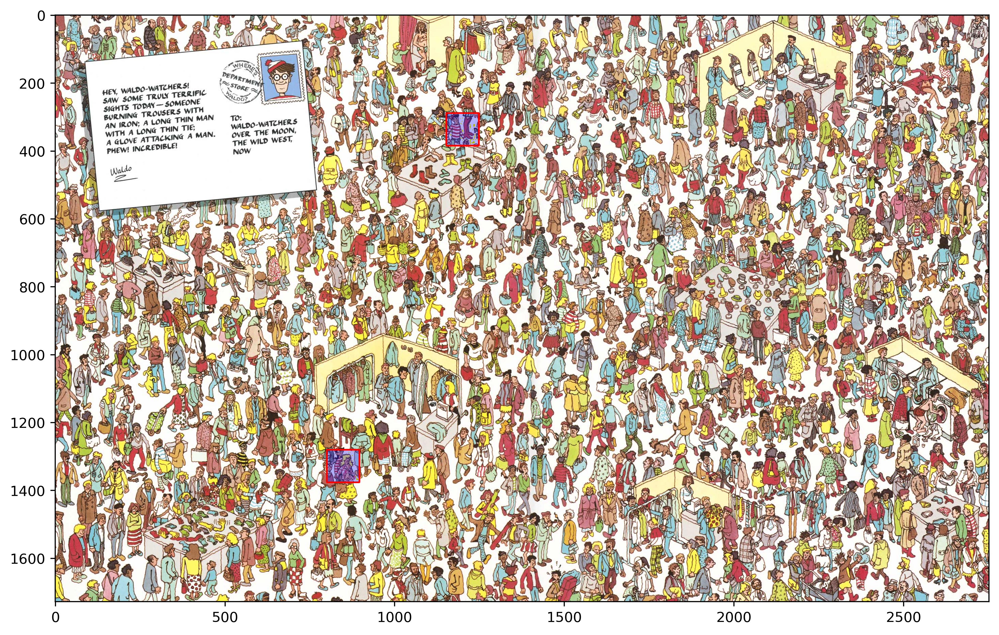

In [28]:
#example
#feel free to plug in your own images!
path, stridelength = r"D:\Denmark\Neural Final\Waldo Full Images/waldo10.jpeg", 32
locate_and_mask(path, stridelength)
#4558 images checked: waldo found, one false positive!